In [164]:
import requests
import os
import geopandas as gpd
import pandas as pd
import numpy as np
from shapely import wkt
from shapely.geometry import Point
import matplotlib.pyplot as plt
import folium

In [328]:
import plotly.graph_objects as go

In [45]:
import warnings
warnings.filterwarnings("ignore")

In [42]:
path_15 = ['data/mappluto_15v1/Bronx/BXMapPLUTO.shp',
           'data/mappluto_15v1/Brooklyn/BKMapPLUTO.shp',
           'data/mappluto_15v1/Manhattan/MNMapPLUTO.shp',
           'data/mappluto_15v1/Queens/QNMapPLUTO.shp',
           'data/mappluto_15v1/Staten_Island/SIMapPLUTO.shp']
path_20 = '../../../Downloads/nyc_pluto_20v6_csv/pluto_20v6.csv'

In [108]:
dfs = []
for path in path_15:
    temp = gpd.read_file(path)
    temp['pluto_year'] = 2015
    dfs.append(temp)
pluto15 = pd.concat(dfs)

In [139]:
pluto20 = pd.read_csv(path_20)

In [140]:
pluto20['geom'] = pluto20.apply(lambda x: Point([x['longitude'], x['latitude']]), axis=1)
pluto20 = gpd.GeoDataFrame(pluto20, geometry='geom')

In [50]:
path_cbg = ['../../../Downloads/geo_data 2/blockgroup_export_000000000000.csv',
            '../../../Downloads/geo_data 2/blockgroup_export_000000000001.csv',
            '../../../Downloads/geo_data 2/blockgroup_export_000000000002.csv',
            '../../../Downloads/geo_data 2/blockgroup_export_000000000003.csv']

In [55]:
dfs = []
for path in path_cbg:
    temp = pd.read_csv(path, dtype={'region_id': str})
    temp['geom'] = temp['geom'].apply(wkt.loads)
    dfs.append(temp)
gdf = pd.concat(dfs)
gdf = gpd.GeoDataFrame(gdf, geometry='geom')

In [81]:
gdf.crs = 'EPSG:4326'

# Lets spatially join CBGs to PLUTO data

In [119]:
pluto15 = pluto15.to_crs("EPSG:4326")

In [120]:
cbg_pluto15 = gpd.sjoin(gdf[gdf['region_id'].str.startswith('36')],
                        pluto15, op='contains')

In [134]:
pluto20.crs = 'EPSG:4326'

In [142]:
cbg_pluto20 = gpd.sjoin(gdf[gdf['region_id'].str.startswith('36')],
                        pluto20, op='contains')

# Let calculate the metrics

In [227]:
retail15 = cbg_pluto15[['region_id', 'BldgArea', 'RetailArea']].groupby('region_id').sum()

In [229]:
retail20 = cbg_pluto20[['region_id', 'bldgarea', 'retailarea']].groupby('region_id').sum()

In [231]:
combined = retail20.merge(retail15, left_index=True, right_index=True)

In [265]:
combined['bldg_pct_change'] = (combined['bldgarea'] - combined['BldgArea'] ) / combined['BldgArea']

In [237]:
combined = gdf.merge(combined, left_on='region_id', 
                     right_index=True)

In [268]:
combined.replace(np.inf, np.nan, inplace=True)
combined.fillna(0, inplace=True)

<AxesSubplot:>

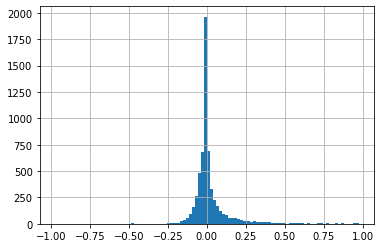

In [276]:
combined['bldg_pct_change'].loc[combined['bldg_pct_change']<1].hist(bins=100)

<AxesSubplot:>

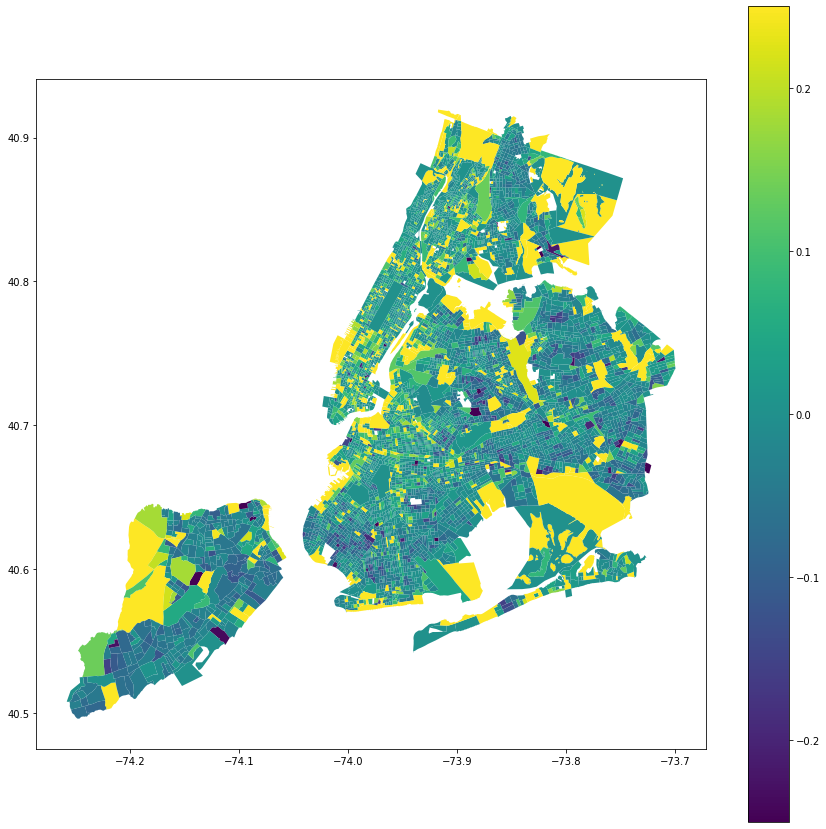

In [282]:
combined.plot(column='bldg_pct_change', legend=True, 
              vmin=-.25,vmax=.25, 
              figsize=(15,15))

In [295]:
combined['folium_pct'] = combined['bldg_pct_change'].clip(-.25, .25)

# Lets plot change in retail area by blockgroup

In [165]:
style_fnc = lambda x: {'fillColor': '#ffffff',
                       'color':'#000000',
                       'fillOpacity': 0.1,
                       'weight': 0.1}
highlight_fnc = lambda x: {'fillColor': '#000000',
                           'color':'#000000',
                           'fillOpacity': 0.50,
                           'weight': 0.1}

In [299]:
x = combined.centroid.x.mean()
y = combined.centroid.y.mean()
f_map = folium.Map(location=[y, x], zoom_start=11, tiles='OpenStreetMap')

In [300]:
folium.Choropleth(
    geo_data=combined,
    data=combined,
    columns=['region_id', 'folium_pct'],
    key_on='feature.properties.region_id',
    fill_color='RdYlGn',
    fill_opacity=1,
    line_opacity=0.15,
    legend_name='Change in built area',
    bins=[ -.25, -.2, -0.15, -0.1, -.05, 0., .05, .1, .15, .2, .25]
).add_to(f_map)

In [301]:
interact = folium.features.GeoJson(
    combined,
    style_function=style_fnc,
    control=False,
    highlight_function=highlight_fnc,
    tooltip=folium.features.GeoJsonTooltip(
        fields=['region_id', 'bldg_pct_change'],
        aliases=['Blockgroup: ','Change in built area (%): '],
        style=("background-color: white; color: #333333; font-family: arial; font-size: 12px; padding: 10px;")
    )
)
f_map.add_child(interact)
f_map.keep_in_front(interact)
folium.LayerControl().add_to(f_map)
f_map

In [302]:
f_map.save("bldg_change_map.html")

# Lets plot the distribution of built area

In [318]:
cols = ['resarea', 'officearea', 'retailarea', 
        'factryarea', 'comarea', 
        'COUNTYFP']

In [322]:
radar_df = cbg_pluto20[cols].groupby('COUNTYFP').apply(lambda x: (x != 0).sum())

In [324]:
radar_df = radar_df.T
radar_df.drop([59, 119], axis=1, inplace=True)

In [326]:
radar_df.columns = ['bronx', 'brooklyn', 'manhattan', 
                    'queens', 'staten_island']

In [338]:
normalized_df = (radar_df.T - radar_df.T.min()) / (radar_df.T.max() - radar_df.T.min())

In [343]:
normalized_df = normalized_df.T

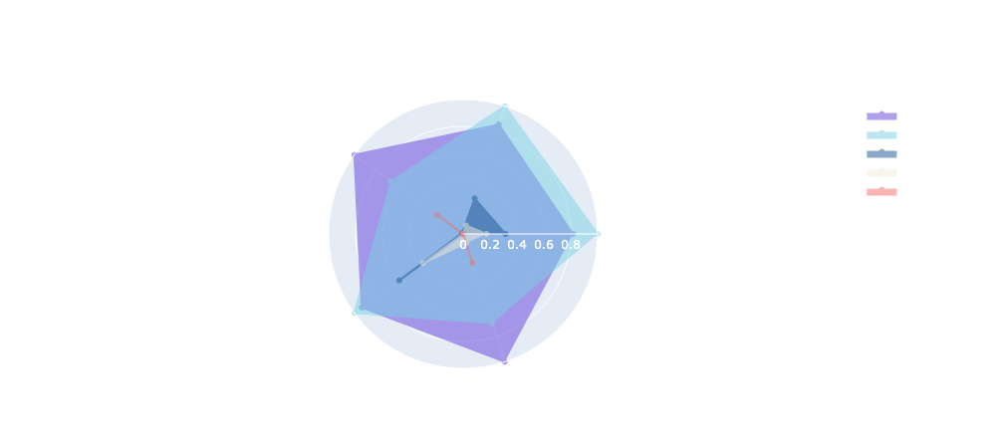

In [369]:
variables = cols[:-1]
fig = go.Figure()

fig.add_trace(go.Scatterpolar(
      r=normalized_df['brooklyn'],
      theta=variables,
      fill='toself',
      name='brooklyn',
      opacity=.5,
      fillcolor='#6340da',
       line=dict(
                color='#6340da',
                width=2)
))
fig.add_trace(go.Scatterpolar(
      r=normalized_df['queens'],
      theta=variables,
      fill='toself',
      name='queens',
      opacity=.5,
      fillcolor='#7ad1e4',
       line=dict(
                color='#7ad1e4',
                width=2)
))
fig.add_trace(go.Scatterpolar(
      r=normalized_df['staten_island'],
      theta=variables,
      fill='toself',
      name='staten_island',
      opacity=.5,
      fillcolor='#175493',
       line=dict(
                color='#175493',
                width=2)
))
fig.add_trace(go.Scatterpolar(
      r=normalized_df['bronx'],
      theta=variables,
      fill='toself',
      name='bronx',
      opacity=.5,
      fillcolor='#f3ecdc',
       line=dict(
                color='#f3ecdc',
                width=2)
))
fig.add_trace(go.Scatterpolar(
      r=normalized_df['manhattan'],
      theta=variables,
      fill='toself',
      name='manhattan',
      opacity=.5,
      fillcolor='#f36C68',
       line=dict(
                color='#f36C68',
                width=2)
))

fig.update_layout(
  polar=dict(
    radialaxis=dict(
      visible=True,
      range=[0, 1]
    )),
    paper_bgcolor='rgba(0,0,0,0)',
    plot_bgcolor='rgba(0,0,0,0)',
    font_color='white',
  showlegend=True
)

fig.show(config= {'displaylogo': False,
             'displayModeBar': False})

In [370]:
fig.write_html("exampleRadar.html", config= {'displaylogo': False,
             'displayModeBar': False})